## Step 1: Understanding the Properties Configuration

Let's examine the properties.yaml file and understand what each parameter does. This configuration file controls every aspect of SHERLOCK's behavior.

### Create an annotated version of the properties file with detailed explanations
```bash
# ============================================================================
# SHERLOCK PROPERTIES FILE - DETAILED EXPLANATION
# ============================================================================

# TARGET SPECIFICATION
# -------------------
TARGETS:
  TIC 305048087:  # TESS Input Catalog ID - the star we want to analyze
                  # SHERLOCK will automatically download light curve data
                  # from TESS for this target
    SECTORS: [2]    # The sectors data to download for the selected target

# DETRENDING CONFIGURATION
# -----------------------
AUTO_DETREND_ENABLED: False     # Disable automatic detrending of stellar variability
                                # Set to True for fast rotators or variable stars
                                # CAUTION: Can remove real transit signals!

INITIAL_HIGH_RMS_MASK: False    # Don't apply initial high-RMS masking
                                # When True, masks high-noise regions in short cadence data

INITIAL_SMOOTH_ENABLED: True    # Apply Savitzky-Golay smoothing filter
                                # When True, applies initial smoothing to short cadence data

INITIAL_HIGH_RMS_THRESHOLD: 2.0 # Threshold multiplier for high-RMS detection
                                # Areas with RMS > threshold*median_RMS are masked

SIMPLE_OSCILLATIONS_REDUCTION: False # Don't reduce stellar oscillations
                                     # Useful for asteroseismology targets

INITIAL_MASK:                   # No initial time ranges to mask
                                # Format: [start_time, end_time] in TESS time

# COMMENTED TRANSIT MASK EXAMPLE:
# INITIAL_TRANSIT_MASK:         # Mask known transits to search for additional planets
#   - P: 5.433729               # Period in days
#     T0: 1355.24981            # Transit epoch (TESS time)
#     D: 120                    # Transit duration in minutes

# DATA SELECTION
# -------------
EXPTIME: [120]                  # Use 2-minute cadence data (120 seconds)
                                # Options: [120] for short cadence, [1800] for long cadence

# COMMENTED AUTHOR FILTERS:
# AUTHOR: [Kepler]              # Use only Kepler mission data
# AUTHOR: TESS-SPOC             # Use only TESS-SPOC pipeline data

# PROCESSING PARAMETERS
# --------------------
DETRENDS_NUMBER: 10             # Number of detrend models to create
                                # More models = better systematics removal but slower
                                # Typical range: 5-12

DETREND_CORES: 6               # CPU cores for parallel detrending
                                # Should not exceed your system's core count

CPU_CORES: 6                   # CPU cores for main processing
                                # Adjust based on your system capabilities

MAX_RUNS: 2                     # Maximum number of transit search iterations
                                # Each run searches for the strongest remaining signal
                                # Higher values find more planets but increase false positives

# DETECTION THRESHOLDS
# -------------------
SNR_MIN: 5                      # Minimum Signal-to-Noise Ratio for detection
                                # Lower values = more sensitive but more false positives
                                # Typical range: 5-8

SDE_MIN: 5                      # Minimum Signal Detection Efficiency
                                # Statistical significance threshold
                                # SDE > 5 corresponds to ~99.9% confidence

# PERIOD SEARCH RANGE
# ------------------
PERIOD_MIN: 0.75                # Minimum orbital period to search (days)
                                # Shorter periods may be affected by systematic noise

PERIOD_MAX: 10                  # Maximum orbital period to search (days)
                                # Limited by observation baseline and transit probability

# SIGNAL SELECTION
# ---------------
MIN_QUORUM: 0.333               # Minimum fraction of detrend models that must agree
                                # Higher values = more conservative candidate selection
                                # Range: 0.1 (liberal) to 0.8 (very conservative)

# DATA PROCESSING
# --------------
TRUNCATE_BORDERS_DAYS: 0.5      # Remove data from sector edges (days)
                                # Helps avoid systematic effects at sector boundaries
                                # Typical range: 0.5-2.0 days
```

## Step 2: Running SHERLOCK with the Properties File

Now let's execute SHERLOCK using our properties configuration. This will search for transit signals in the TIC 305048087 light curve.


SHERLOCK Command:

`python3 -m sherlockpipe --properties properties.yaml`

This command will:

1. Download TESS data for TIC 305048087
2. Create 10 different detrend models
3. Search for transit signals in each model
4. Apply quorum voting to select reliable candidates
5. Generate comprehensive reports and plots

In [ ]:
# Execute SHERLOCK search
!python3 -m sherlockpipe --properties /home/martin/workspace/ph/SHERLOCK/docs/source/_static/properties.yaml > sherlock.log

/home/martin/anaconda3/envs/sherlock311/lib/python3.11/site-packages/lightkurve/config/__init__.py:119: UserWarning: The default Lightkurve cache directory, used by download(), etc., has been moved to /home/martin/.lightkurve/cache. Please move all the files in the legacy directory /home/martin/.lightkurve-cache to the new location and remove the legacy directory. Refer to https://docs.lightkurve.org/reference/config.html#default-cache-directory-migration for more information.
  warnings.warn(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
...


In [2]:
results_dir = '/home/martin/workspace/TIC305048087_[2]'

### Examining Planet Candidates

After running SHERLOCK, the tool searches for transit signals across multiple detrend models and identifies potential planet candidates. 
The list of resulting files should be something similar to:

#### Directories:

* **1/ and 2/**: These numbered directories contain results for each detection run. SHERLOCK performs multiple runs (based on MAX_RUNS in your properties.yaml), with each run focusing on finding additional signals after masking previously detected ones.
* **detrends/**: Contains plots and data of the different detrending methods applied to the light curve. SHERLOCK creates multiple detrend models (10 in your case, as specified in properties.yaml).
* **flux_diff/**: Includes visualizations showing the difference in flux between pixels to help identify source contamination.
* **fov/**: Contains "Field of View" images showing the target star and nearby stars that might contaminate the signal.
* **periodicity/**: Contains periodogram analysis results to identify periodic signals in the data.
* **tpfs/**: Target Pixel Files directory with pixel-level data and visualizations.

#### Files:

* **apertures.yaml**: Defines the photometric aperture(s) used for extracting the light curve.
* **candidates.csv**: Summary table of all planet candidates detected across all runs, with their key parameters.
* **lc_0.csv through lc_9.csv**: The 10 different detrended light curves (matching DETRENDS_NUMBER in your properties.yaml).
* **lc.csv**: The original extracted light curve before detrending.
* **lc_data.csv**: Comprehensive light curve data including quality flags and other metadata.
* **params_star.csv**: Contains stellar parameters (radius, mass, temperature, etc.) used for planet characterization.
* **properties.yaml**: A copy of the configuration file used for this analysis.
* **TIC305048087_[2]_candidates.log**: Log file specifically for candidate detection information.
* **TIC305048087_[2]_report.log**: The main report log with comprehensive analysis information.
* **transits_stats.csv**: Statistical information about the detected transit signals.

Below, we'll load and display the search results from the log file to examine what planet candidates were found during the detection process.

The log shows important information for each candidate, including:
- Period (days)
- Transit depth (in parts per thousand)
- Signal-to-noise ratio (SNR)
- Signal detection efficiency (SDE)
- Duration of the transit (minutes)
- Border score (quality indicator)
- Planet radius estimation (in Earth radii)
- Habitability zone classification

#### TIC305048087_[2]_candidates.log
The content of the candidates log contains two lines for TOI-237.01 and TIC 305048087.02

In [ ]:
import sys
import platform
import os
from IPython.display import HTML

# Function to load and display the entire log file in a scrollable container
def display_log_file(log_path, max_height=500):
    try:
        with open(log_path, 'r') as file:
            log_content = file.read()
        
        # Create scrollable div with the log content
        html = f"""
        <div style="max-height:{max_height}px; overflow:auto; border:1px solid #ccc; padding:8px; font-family:monospace; font-size:0.9em;">
        <pre>{log_content}</pre>
        </div>
        """
        
        return HTML(html)
    except Exception as e:
        return f"Error loading log file: {str(e)}"

display_log_file(results_dir + '/TIC305048087_[2]_candidates.log')

For a better understanding of the selected signals, we can plot their best matches looking into the **/1** and **/2** directories:

#### TOI 237.01 selected signal


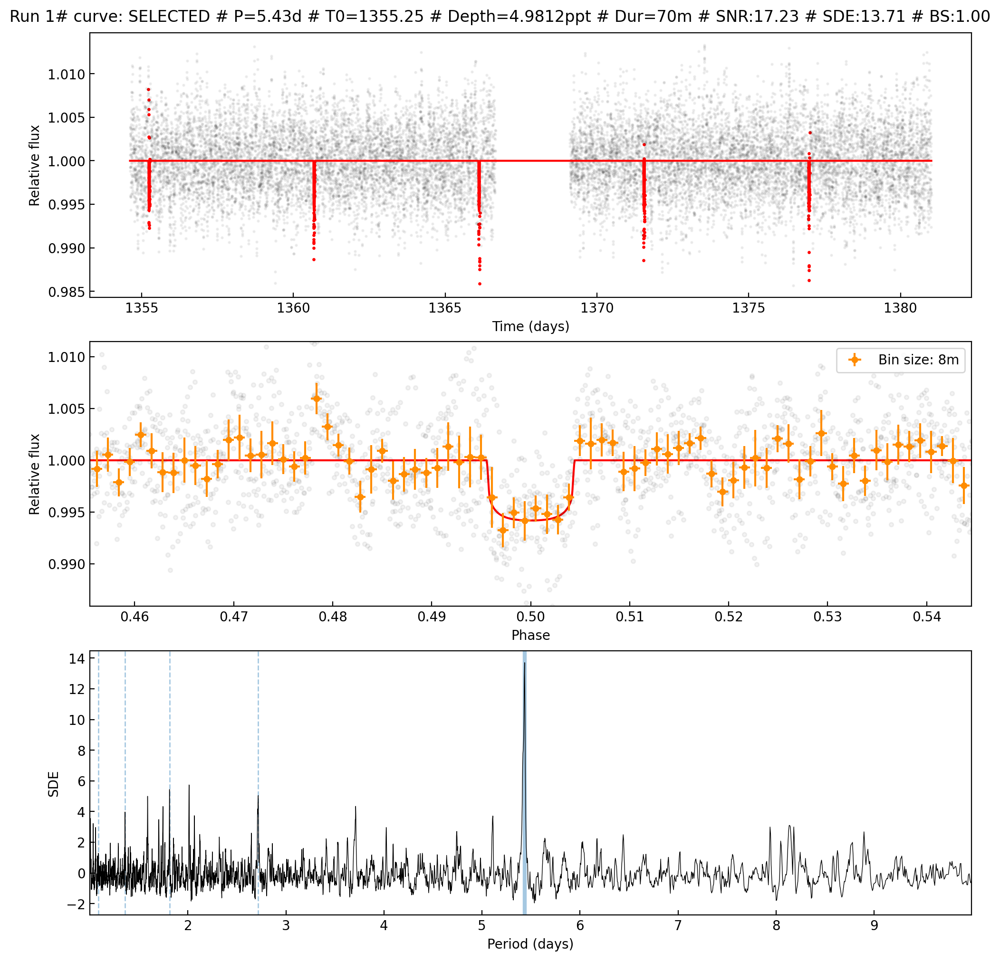

In [ ]:
from PIL import Image
from IPython.display import display

# Open and display the image
img = Image.open(results_dir + '/1/Run_1_SELECTED_10_TIC305048087_[2].png')
display(img)

#### TIC 305048087.02 selected signal

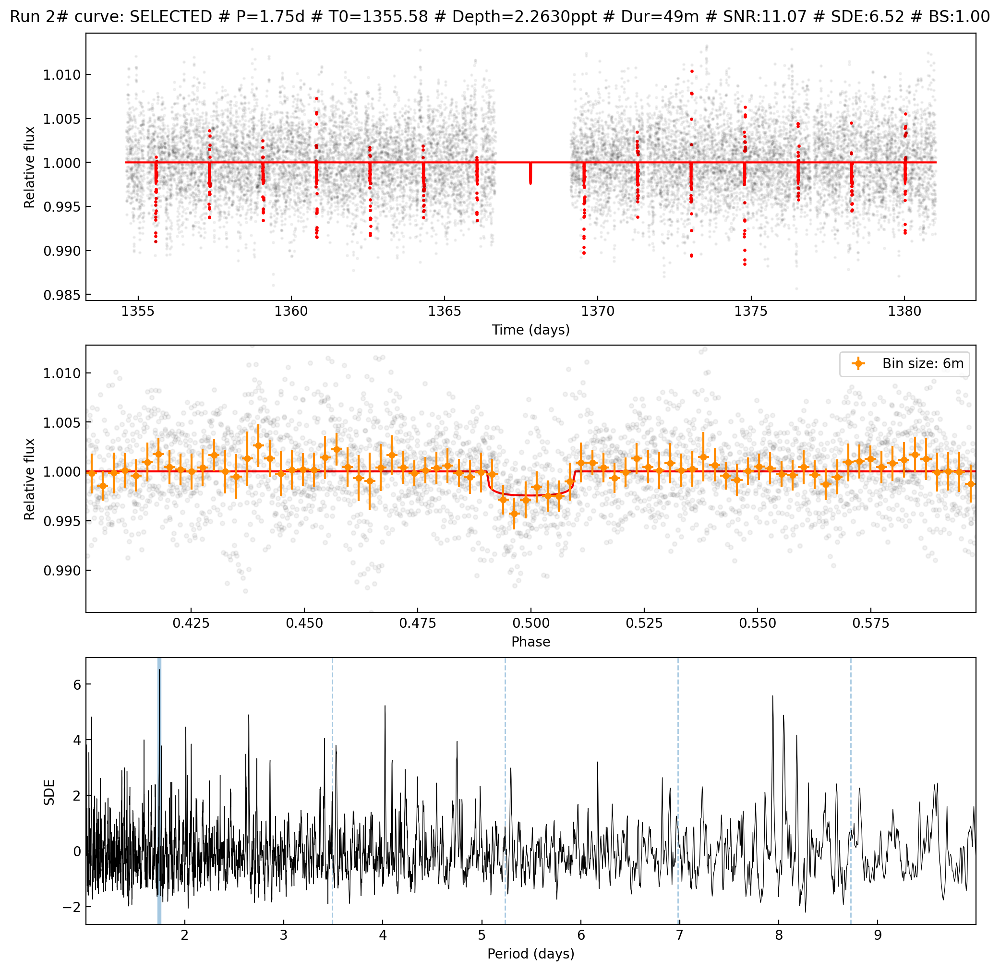

In [ ]:
from PIL import Image
from IPython.display import display

# Open and display the image
img = Image.open(results_dir + '/2/Run_2_SELECTED_8_TIC305048087_[2].png')
display(img)

Even when this last signal doesn't show a really good power spectrum, its shape is very promising and we will keep it for further analysis.

## Step 3: Selected signals bayesian fit

We are interested in understanding the two selected signals. To examine them or prepare follow-up programs, we first need to run a bayesian fit to refine the transit parameters. SHERLOCK has a built-in fit module that is very easy to run. We will run it for the two signals:

In [ ]:
# Moving to sherlock target directory
os.chdir(results_dir)

In [ ]:
# Execute fit for TOI 237.01
!python3 -m sherlockpipe.fit --candidate 1 --cpus 6 > fit1.log
# Execute fit for TIC 305048087.02
!python3 -m sherlockpipe.fit --candidate 2 --cpus 6 > fit2.log

/home/martin/anaconda3/envs/sherlock311/lib/python3.11/site-packages/lightkurve/config/__init__.py:119: UserWarning: The default Lightkurve cache directory, used by download(), etc., has been moved to /home/martin/.lightkurve/cache. Please move all the files in the legacy directory /home/martin/.lightkurve-cache to the new location and remove the legacy directory. Refer to https://docs.lightkurve.org/reference/config.html#default-cache-directory-migration for more information.
  warnings.warn(
100%|█████████████████████████████████████████████| 5/5 [00:00<00:00, 23.87it/s]
15020it [10:26:14,  2.50s/it, batch: 5 | bound: 30 | nc: 1 | ncall: 385300 | eff(%):  3.757 | loglstar: 4017.576 < 4024.635 < 4022.855 | logz: 4013.690 +/-  0.095 | stop:  0.974]   
100%|█████████████████████████████████████████████| 5/5 [00:04<00:00,  1.12it/s]
/home/martin/anaconda3/envs/sherlock311/lib/python3.11/site-packages/lightkurve/config/__init__.py:119: UserWarning: The default Lightkurve cache directory, 

There are now two new directories `fit_[1]` and `fit_[2]`, each containing the results of the two bayesian fits. Under each directory there are many files for deep inspection by the user. However, SHERLOCK compiles a summary of the results in each `TIC 305048087_fit.pdf` file.

### TOI 237.01 fit report


Page 1


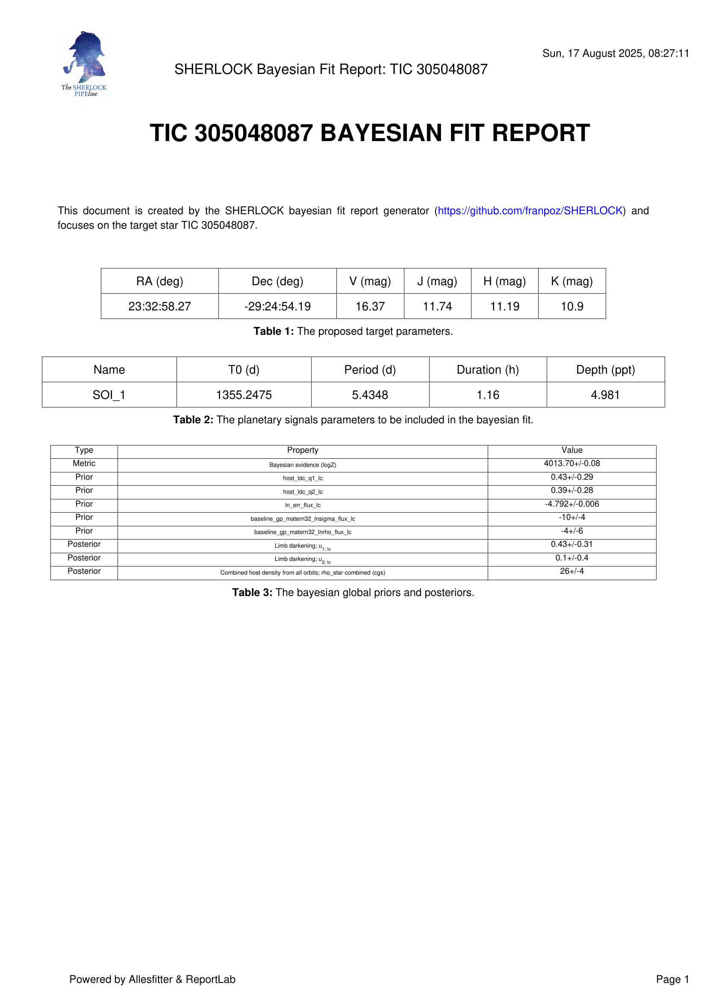

Page 2


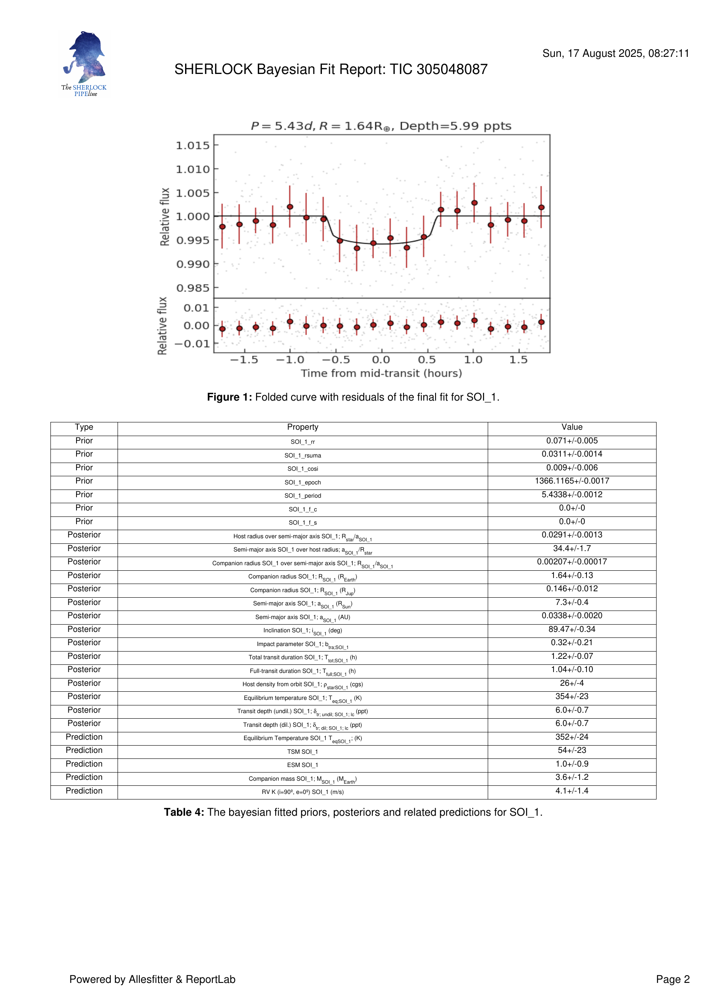

In [ ]:
!python3 -m pip install pdf2image

from pdf2image import convert_from_path
from IPython.display import display, Image
import matplotlib.pyplot as plt

# Convert PDF pages to images
pages = convert_from_path(results_dir + '/fit_[1]/TIC 305048087_fit.pdf', 200)  # 200 DPI resolution

# Display each page as an image
for i, page in enumerate(pages):
    print(f"Page {i+1}")
    display(page)  # Or use plt.imshow(page) for more control

### TIC 305048087.02 fit report

Page 1


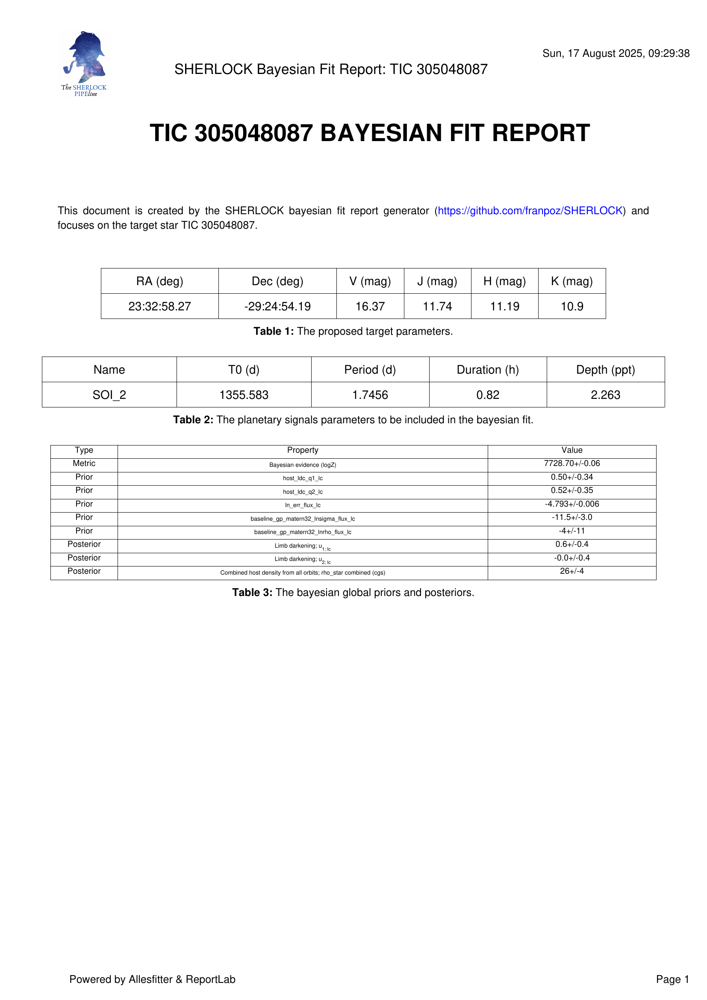

Page 2


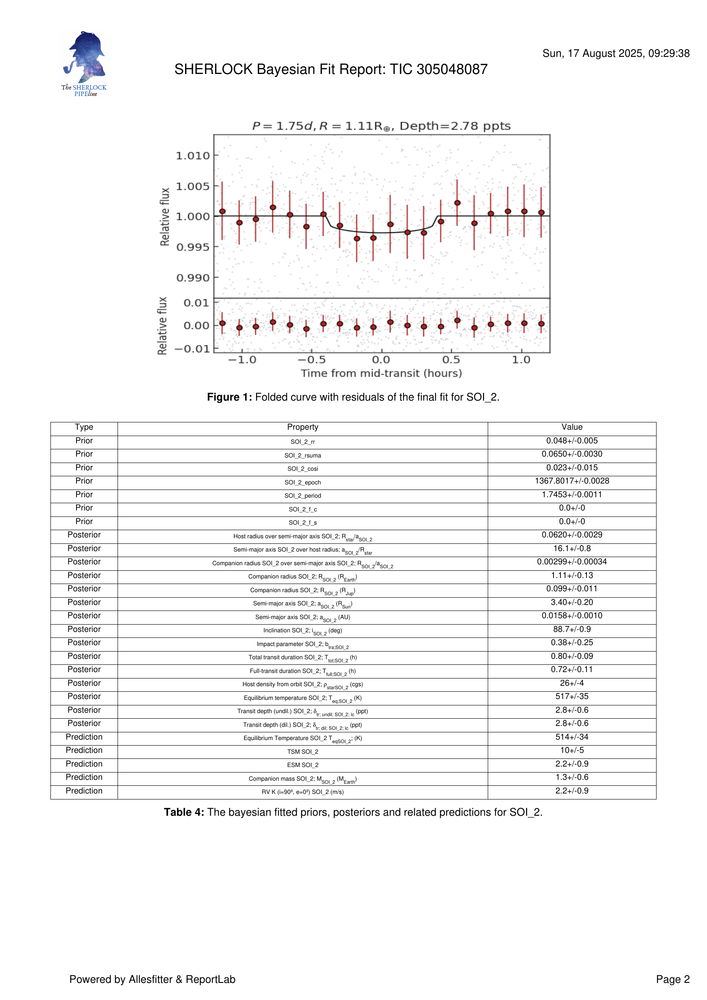

In [ ]:
from pdf2image import convert_from_path
from IPython.display import display, Image
import matplotlib.pyplot as plt

# Convert PDF pages to images
pages = convert_from_path(results_dir + '/fit_[2]/TIC 305048087_fit.pdf', 200)  # 200 DPI resolution

# Display each page as an image
for i, page in enumerate(pages):
    print(f"Page {i+1}")
    display(page)  # Or use plt.imshow(page) for more control

## Step 4: Candidates vetting

Having obtained robust parametric models for both planetary candidates through the fitting procedure, we can now proceed to quantitative signal validation. While the validation metrics can be computed without prior fitting, utilizing the derived orbital and physical parameters significantly enhances the accuracy of the vetting diagnostics and provides essential context for signal interpretation.

SHERLOCK's validation module provides a streamlined implementation of standard vetting procedures. The module can be executed via straightforward command-line operations, with separate processes required for each candidate to ensure independent validation. The following commands initiate the validation procedure for each of our detected signals:

In [ ]:
# Vetting for TOI 237.01
!python3 -m sherlockpipe.vet --candidate 1 --ml --cpus 4 > vet1.log

# Vetting for TIC 305048087.02
!python3 -m sherlockpipe.vet --candidate 2 --ml --cpus 4  > vet2.log

2025-08-17 09:31:14.452131: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
..........


Upon completion of the analysis, the target directory now contains two vetting subdirectories: `vet_1` and `vet_2`. The raw data from the vetting process is preserved in CSV format to facilitate further analysis and custom applications. SHERLOCK synthesizes the vetting results into two comprehensive reports: `TIC 305048087_transits_validation_report.pdf` and `TIC 305048087_transits_validation_report_summary.pdf`. 

The comprehensive report presents a complete analysis of all detected transit events, while the summary report provides a representative subset of transit profiles—specifically the transit with depth closest to the mean, the maximum depth transit, and the minimum depth transit—thereby offering an efficient overview of the signal characteristics without exhaustive event-by-event documentation.

The validation reports are displayed below.

### TOI 237.01 vetting report

In [ ]:
import base64
from IPython.display import HTML

with open(f"{results_dir}/vet_1/TIC 305048087_transits_validation_report_summary.pdf", "rb") as f:
    encoded_pdf = base64.b64encode(f.read()).decode("utf-8")
data_uri = f"data:application/pdf;base64,{encoded_pdf}"
# HTML block with both options
html = f"""
<ul>
    <li><a href="{data_uri}" download="toi237-01report.pdf">TOI 237.01 vetting report</a></li>
</ul>
"""
display(HTML(html))

#### 🪐 TOI 237.01 vetting summary

##### 🔭 Overview
- **Target**: TIC 305048087  
- **Detected Signal**:  
  - **Period**: 5.4338 days  
  - **Transit Depth**: 5.993 ppt  
  - **Duration**: 1.22 hours  

---

#### 📊 Validation Metrics
| Metric                  | Value     |
|-------------------------|-----------|
| **WATSON-NET score**    | 0.763     |
| **WATSON-NET error**    | 0.321     |
| **Triceratops FPP**     | 0.235     |
| **NFPP**                | 0.0       |
| **Signal-to-Noise Ratios** |        |
| - Short SNR             | 6.30      |
| - Long SNR              | 5.51      |
| - Overall SNR           | 16.93     |

---

##### 🧠 WATSON-Net Explainability
- High-impact positive features:
  - Centroid shifts (RA and Dec)
  - Odd-even and core/halo flux branches
- Strong sensitivity to:
  - Planet radius
  - Transit period and duration

---

##### 🛰️ Triceratops Scenario Probabilities
- **Most likely scenario**: Transiting Planet (TP)  
  - **Probability**: 33.6%
- **Other scenarios** (eclipsing binaries, blends): low probability
- **Mean FPP**: 23.5%

| Scenario | Description              | Probability |
|----------|--------------------------|-------------|
| TP       | Transiting Planet        | 0.336       |
| DTP      | Diluted Transiting Planet | 0.338       |
| BEB      | Background Eclipsing Binary | 0.099   |
| Others   | All other scenarios      | < 0.03      |

---

##### 📍 Centroid and Offset Analysis
- **Transit position offset**: 0.001 deg → consistent with on-target event  
- **Centroid SNR**:
  - RA: -0.443
  - Dec: -2.611  
- No significant centroid shift detected

---

##### 📉 Vetting Summary
- No detected secondary eclipses  
- No significant odd-even differences  
- Clean signal in:
  - Core and halo photometry
  - Pixel-level diagnostics
- Diagnostic plots support on-target, symmetric transits

---

##### ✅ Conclusion
The transit signal detected in TIC 305048087 is **consistent with a planetary candidate**.  
While the **False Positive Probability (FPP ≈ 0.235)** is above strict statistical validation thresholds, key metrics support a **genuine exoplanet** scenario:

- Strong SNR
- No nearby source contamination
- Stable centroids
- Neural network classification favors a planet

**→ Follow-up observations are recommended** for confirmation.

### TIC 305048087 vetting report

In [ ]:
import base64
from IPython.display import HTML

with open(f"{results_dir}/vet_1/TIC 305048087_transits_validation_report_summary.pdf", "rb") as f:
    encoded_pdf = base64.b64encode(f.read()).decode("utf-8")
data_uri = f"data:application/pdf;base64,{encoded_pdf}"
# HTML block with both options
html = f"""
<ul>
    <li><a href="{data_uri}" download="tic305048087-02-report.pdf">TOI 305048087.02 Vetting Report</a></li>
</ul>
"""
display(HTML(html))

#### 🪐 TIC 305048087.02 vetting summary

##### 🔭 Overview
- **Target**: TIC 305048087  
- **Detected Signal**:  
  - **Period**: 1.7453 days  
  - **Transit Depth**: 2.783 ppt  
  - **Duration**: 0.8 hours  

---

##### 📊 Validation Metrics
| Metric                  | Value     |
|-------------------------|-----------|
| **WATSON-NET score**    | 0.024     |
| **WATSON-NET error**    | 0.03      |
| **Triceratops FPP**     | 0.714     |
| **NFPP**                | 0.0       |
| **Signal-to-Noise Ratios** |        |
| - Short SNR             | 3.54      |
| - Long SNR              | 4.59      |
| - Overall SNR           | 10.83     |

---

##### 🧠 WATSON-Net Explainability
- Overall low influence from most neural branches  
- Slight positive contributions from:
  - `centroids_ra_strong_branch` (+0.01)  
  - `og_hide_branch` (+0.017)
- Signal features (radius, period, duration) had negligible effect on model confidence

---

##### 🛰️ Triceratops Scenario Probabilities
- **Most likely planetary scenario**:
  - Transiting Planet (TP): 12.6%
  - Diluted TP (DTP): 12.6%
- **Highest probability scenario** overall:
  - Background TP (BTP): 27.2%
  - Background EB (BEB): 28.3%
- **Mean FPP**: ~71.4%

| Scenario | Description              | Probability |
|----------|--------------------------|-------------|
| BTP      | Background Transiting Planet | 0.272   |
| BEB      | Background Eclipsing Binary | 0.283   |
| TP       | Transiting Planet            | 0.126   |
| DTP      | Diluted TP                   | 0.126   |
| Others   | All remaining scenarios      | < 0.04  |

---

##### 📍 Centroid and Offset Analysis
- **Transit position offset**: 0.002 deg → close to target but not as well constrained  
- **Centroid SNR**:
  - RA: +1.23
  - Dec: -0.24  
- No significant centroid deviation

---

##### 📉 Vetting Summary
- No secondary eclipses or odd-even differences  
- Weak optical ghost score (OG = 0.022)  
- Core flux SNR moderately above threshold (4.41), halo flux very low  
- Transit signal visually shallow but coherent

---

##### ⚠️ Conclusion
This signal exhibits **low confidence** from both WATSON-Net and TRICERATOPS:

- **Low WATSON-Net score** (0.024)  
- **High FPP** (~71%)  
- **Shallow depth and low SNR**

However, due to its **on-target origin**, **clean shape**, and **lack of nearby contaminants**, this candidate could represent a **real, low-SNR exoplanet**.

**→ Follow-up observations are recommended**, especially with higher precision photometry or radial velocity monitoring.

## Step 5: TIC 305048087 candidates system stability

The stability of a system composed of the host star and exoplanets in orbits of 1.75d and 5.43d is probably not going to be problematic. However,
it is interesting to understand how the SHERLOCK process should handle this case. The stability execution can be run with or without a prior bayesian fit. It can also be run from a yaml file (e.g. [stability.yaml – SHERLOCK examples (properties)](https://github.com/franpoz/SHERLOCK/blob/master/examples/properties/stability.yaml)) with the next command:

`python3 -m sherlockpipe.stability --cpus 4 --properties stability.yaml --years 10000`

However, it might be much more comfortable to rely on the already SHERLOCK prepared data and avoid writing up a custom yaml file. We will explore grid of 20 eccentricities up to 0.5 for each planet, keeping the rest of values fixed. The stability framework SHERLOCK uses is based on `rebound`, using the MEGNO index as a stability indicator. We only count with the planetary radii from the SHERLOCK previous executions, and hence, we need some way to infer thei masses. SHERLOCK automatically forecast these using the MR-relationship forecasting method from Chen J., Kipping D., (2017).

In [ ]:
!python3 -m sherlockpipe.stability --cpus 4 --candidate 1,2 --years 1000 --ecc_bins 20 --repetitions 10

No module named 'cupy'
Won't be able to use GPU
/home/martin/anaconda3/envs/sherlock311/lib/python3.11/site-packages/lightkurve/config/__init__.py:119: UserWarning: The default Lightkurve cache directory, used by download(), etc., has been moved to /home/martin/.lightkurve/cache. Please move all the files in the legacy directory /home/martin/.lightkurve-cache to the new location and remove the legacy directory. Refer to https://docs.lightkurve.org/reference/config.html#default-cache-directory-migration for more information.
  warnings.warn(
2025-08-18 11:09:27 INFO     Starting stability validation
2025-08-18 11:09:27 INFO     Simulation set to maximum time of 10000 years
2025-08-18 11:09:27 INFO     2 planets to be simulated
2025-08-18 11:09:27 INFO     Lowest star mass: 0.16
2025-08-18 11:09:27 INFO     Highest star mass: 0.20
2025-08-18 11:09:27 INFO     Star mass bins: 1
2025-08-18 11:09:27 INFO     Body 0: {"period": 5.433828547960967, "period_low_err": 0.0011758933456063048, "per

Now, as an example, let's plot the a picture comparing the results for both planets explored eccentricities.

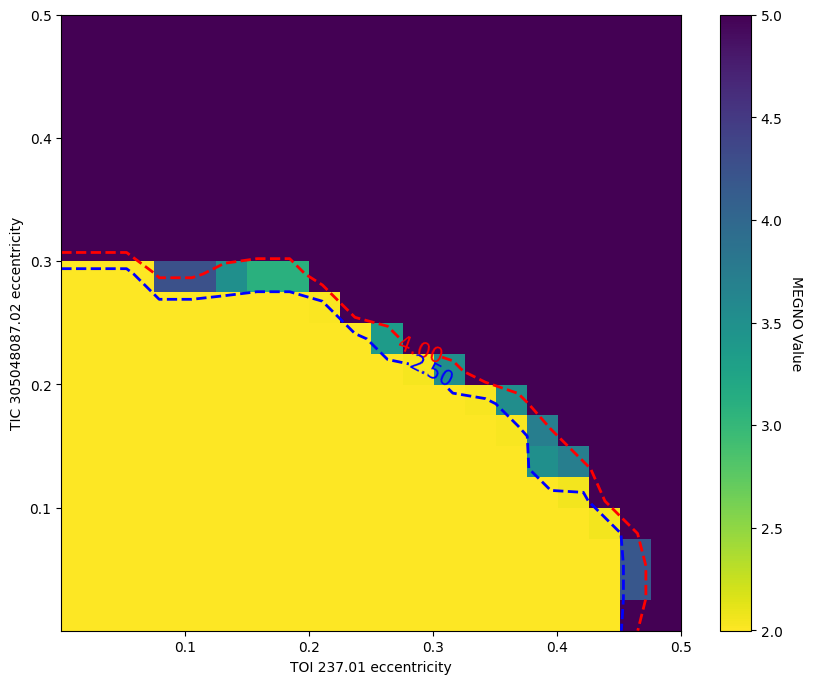

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import median_filter

def plot_stability_by_ecc(results_dir: str, smooth_size: int = 3, limits=[[4, 'red'], [2.5, 'blue']]):
    df = pd.read_csv(results_dir)
    eccentricity_pairs = []
    megno_values = []
    for _, row in df.iterrows():
        e1, e2 = map(float, row['eccentricities'].split(','))
        eccentricity_pairs.append((e1, e2))
        megno_values.append(float(row['megno']))
    eccentricity_pairs = np.array(eccentricity_pairs)
    megno_values = np.array(megno_values)
    e1_unique = np.sort(np.unique(eccentricity_pairs[:, 0]))
    e2_unique = np.sort(np.unique(eccentricity_pairs[:, 1]))
    megno_grid = np.zeros((len(e1_unique), len(e2_unique)))
    megno_grid[:] = np.nan
    for (e1, e2), megno in zip(eccentricity_pairs, megno_values):
        i = np.where(e1_unique == e1)[0][0]
        j = np.where(e2_unique == e2)[0][0]
        megno_grid[i, j] = megno
    megno_grid = median_filter(megno_grid, size=smooth_size)
    fig, ax = plt.subplots(figsize=(10, 8))
    im = ax.imshow(megno_grid,
                   origin='lower',
                   extent=[min(e2_unique), max(e2_unique), min(e1_unique), max(e1_unique)],
                   aspect='auto',
                   cmap='viridis_r')
    for limit in limits:
        contour = ax.contour(
            e2_unique,  # X grid
            e1_unique,  # Y grid
            megno_grid,  # Z grid
            levels=[limit[0]],  # Contour at MEGNO = 5
            colors=limit[1],
            linewidths=2,
            linestyles='--'
        )
        ax.clabel(contour, inline=True, fontsize=15, fmt='%.2f')
    ax.set_xlabel("TOI 237.01 eccentricity")
    ax.set_ylabel("TIC 305048087.02 eccentricity")
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('MEGNO Value', rotation=270, labelpad=15)

plot_stability_by_ecc(f"{results_dir}/stability/stability_megno.csv")

The dashed red line represents the area where no stable orbits are found. The dashed blue line represents the range of eccentricities where most of the random explored scenarios are feasibly stable for 1000 years, showing that eccentricities above 0.3 for TIC 30504807.02 and 0.45 for TOI 237.01, are mostly problematic.

## Step 6: TIC 305048087 candidates follow-up program plan
The final step is to prepare a report containing the observational windows of the candidates for the next year, based on the observatories that we have access to. For this, we need to prepare an `observatories.csv` file as follows:

```csv
name,tz,lat,lon,alt
Trappist-South,,-29.2563,-70.738,2375
Trappist-North,,31.2061,-7.8664,2751
```

Then, we can run the SHERLOCK plan module for each of our candidates (moving to each fit directory and running the plan module). We have to specify the `since` date as this example is old and running the plan with the current date will provide no results due to the ephemerides scattering with time:

In [ ]:
!python3 -m sherlockpipe.plan --candidate 1 --observatories observatories.csv --error_sigma 1 --moon_min_dist 5 --moon_max_dist 20 --since 2020-01-01
!python3 -m sherlockpipe.plan --candidate 2 --observatories observatories.csv --error_sigma 1 --moon_min_dist 5 --moon_max_dist 20 --since 2020-01-01


.......:


### TOI 237.01 follow-up plan
Let's inspect the first two pages of the plan to see the observational windows for our observatories.

Page 1


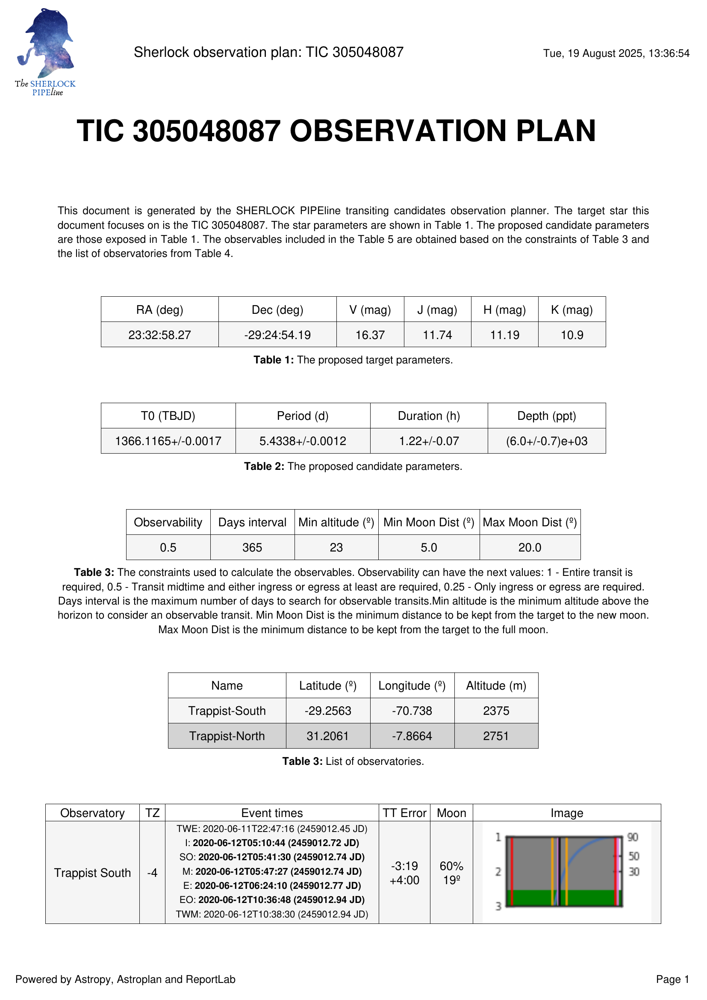

Page 2


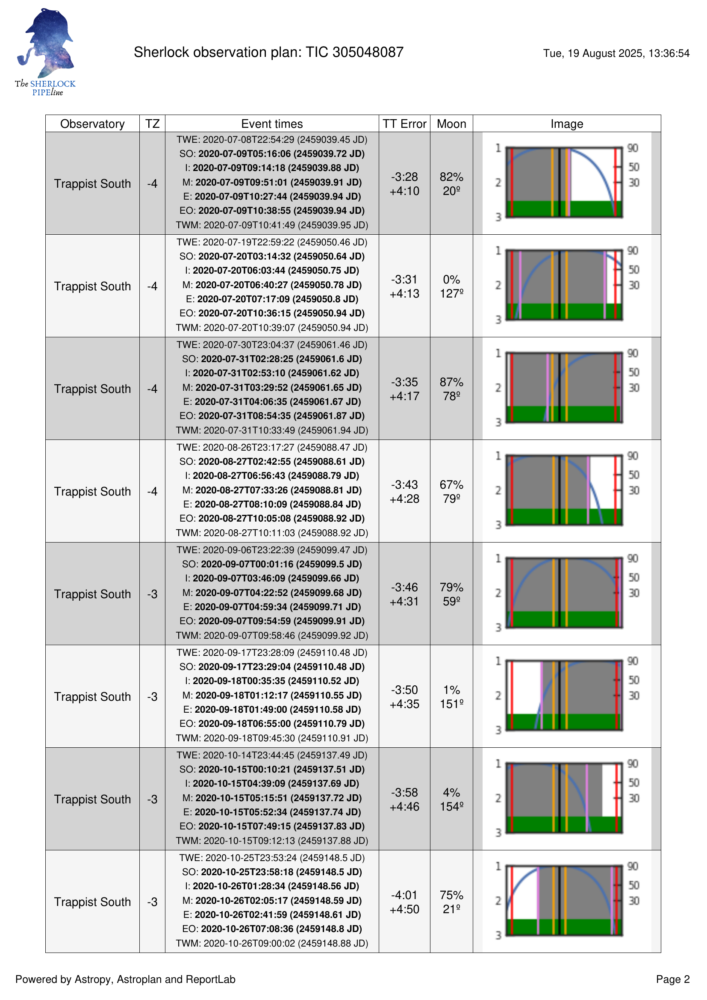

In [ ]:
pages = convert_from_path(results_dir + '/fit_[1]/plan/TIC 305048087_SOI_1_observation_plan.pdf', 200)  # 200 DPI resolution

# Display each page as an image
for i in range(0, 2):
    print(f"Page {i+1}")
    display(pages[i])  # Or use plt.imshow(page) for more control

We can see that several windows are available for Trappist South. The values of moon distance and phase are written on each table row, together to the transit T0 uncertainty. The event times are shown in UTC format together to the timezone of the observatories,

### TIC 305048087.02 follow-up plan

Page 1


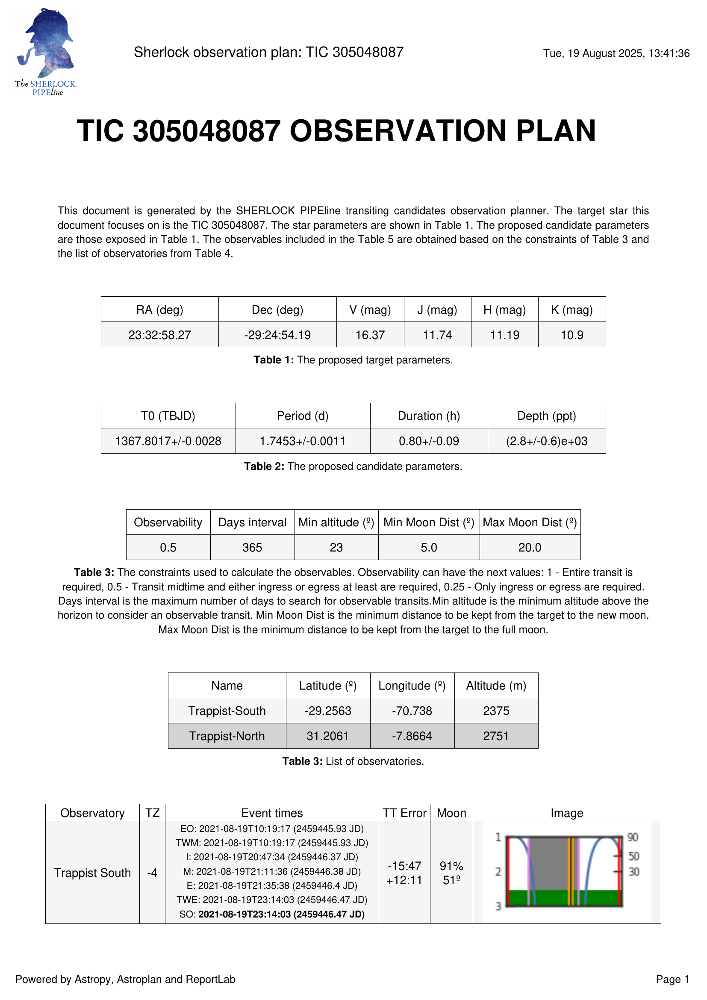

Page 2


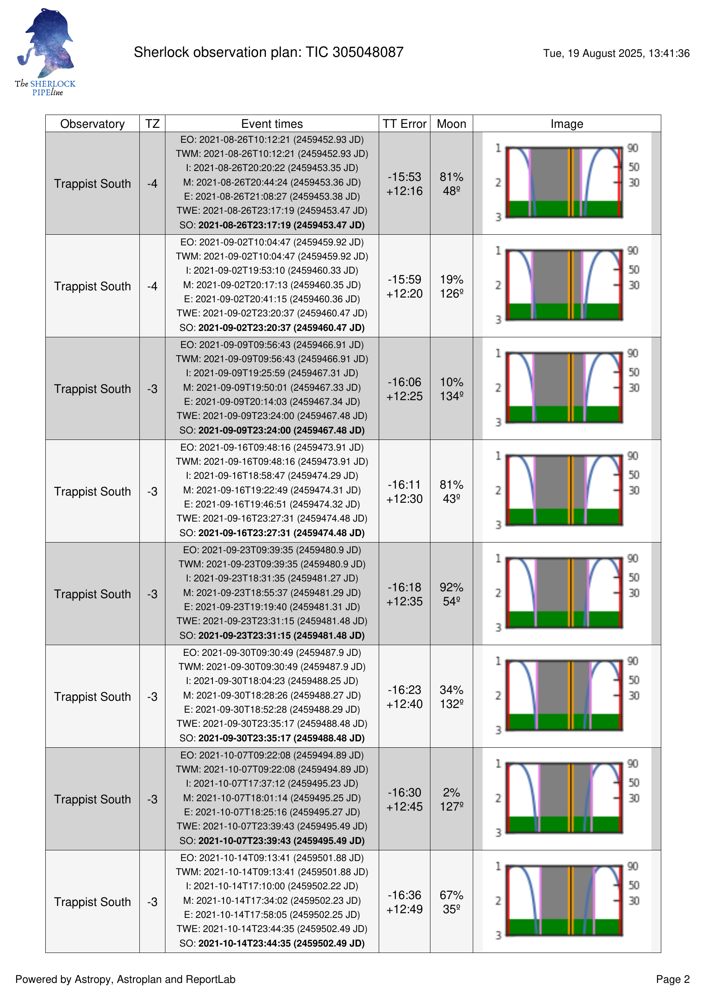

In [ ]:
pages = convert_from_path(results_dir + '/fit_[2]/plan/TIC 305048087_SOI_2_observation_plan.pdf', 200)  # 200 DPI resolution

# Display each page as an image
for i in range(0, 2):
    print(f"Page {i+1}")
    display(pages[i])  # Or use plt.imshow(page) for more control

There is a large uncertainty for this second candidate to be followed-up by our observatories. More TESS sectors would be needed to be able to refine its ephemeris and it from ground-based observations.

## Summary

This tutorial demonstrated:

1. **Properties File Configuration** - Understanding each parameter and its impact
2. **SHERLOCK Search Execution** - Running the search with `python3 -m sherlockpipe --properties properties.yaml`
3. **SHERLOCK bayesian fit** - Refining transit parameters. Run with `python3 -m sherlockpipe.fit --candidate 1`.
4. **SHERLOCK vetting and validation** - Candidates goodness assessment. Run with `python3 -m sherlockpipe.vet --candidate 1`.
5. **SHERLOCK stability module** - Understanding of planetary system architectures. Run with `python3 -m sherlockpipe.stability --candidate 1,2`.
6. **SHERLOCK follow-up planning** - Transit ground-based observability. Run with `python3 -m sherlockpipe.plan --candidate 1 --observatories observatories.csv`.

### Next Steps:

1. Run the complete workflow on your candidates
2. Experiment with different parameter combinations
3. Apply SHERLOCK to your own targets of interest
4. Contribute to exoplanet discovery!
